# Some Aspects of the raw Data

In [1]:
import torch
import nnfabrik
from nnfabrik.builder import get_data, get_model, get_trainer
import cascade

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from lipstick import GifMaker
from mpl_toolkits import mplot3d
%matplotlib inline

In [2]:
import datajoint as dj
dj.config["database.host"] = '18.198.155.36'

dj.config["enable_python_native_blobs"] = True
dj.config['nnfabrik.schema_name'] = "nnfabrik_neural_prediction_challenge"

schema = dj.schema("nnfabrik_neural_prediction_challenge")

Connecting kwilleke@18.198.155.36:3306


In [3]:
filenames = ['/data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip', 
             '/data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip',]

dataset_fn = 'cascade.datasets.static_loaders'
dataset_config = {'paths': filenames,
                 'normalize': True,
                 'include_behavior': False,
                 'include_eye_position': True,
                 'batch_size': 128,
                 'exclude': None,
                 'file_tree': True,
                 'scale': 0.5
                 }

dataloaders = get_data(dataset_fn, dataset_config)

/data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6 exists already. Not unpacking /data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip
/data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6 exists already. Not unpacking /data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip


In [4]:
from nnvision.tables.from_nnfabrik import TrainedModel

In [5]:
key = dict(model_hash='c2dc75a58396ff8341f85a4278254670')
dataloaders, model = (TrainedModel() & key).load_model()

/data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6 exists already. Not unpacking /data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip
/data/mouse/toliaslab/static/static26644-14-17-GrayImageNet-94c6ff995dac583098847cfecd43e7b6 exists already. Not unpacking /data/mouse/toliaslab/static/static26644-14-17-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip


/notebooks/ml-utils/neuralpredictors/layers/cores/conv2d.py:163: UserWarning: group sparsity can not be calculated for the requested conv type. Hidden channels will not be regularized and gamma_hidden is ignored.
  warnings.warn("group sparsity can not be calculated for the requested conv type. Hidden channels will not be regularized and gamma_hidden is ignored.")
/notebooks/ml-utils/neuralpredictors/layers/readouts/base.py:62: UserWarning: Use of 'gamma_readout' is deprecated. Please consider using the readout's feature-regularization parameter instead
  warnings.warn(
/notebooks/ml-utils/neuralpredictors/layers/readouts/base.py:79: UserWarning: Readout is NOT initialized with mean activity but with 0!
  warnings.warn("Readout is NOT initialized with mean activity but with 0!")


In [8]:
data_keys = list(dataloaders["train"].keys())
for data_key in data_keys:
    pass


# Show Anatomical Coordinates

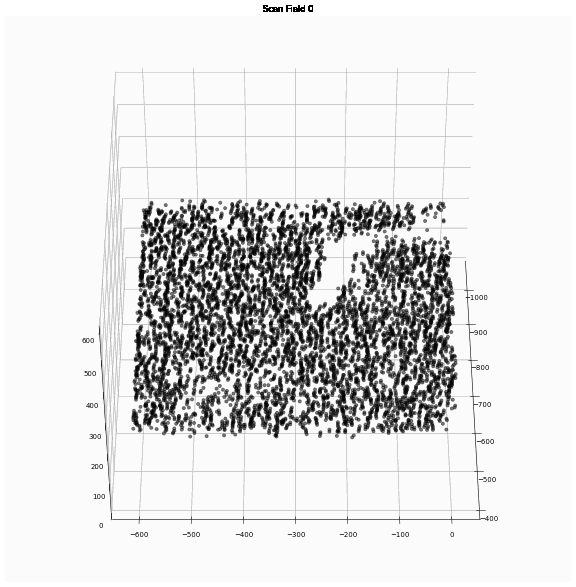

In [519]:


with GifMaker(f"neurons_scan_field_{data_key}.gif", fps=24) as g:

    for azimuth in np.linspace(0, 360, 180):
        
        fig= plt.figure(figsize=(15,15), dpi=50)
        ax = plt.axes(projection='3d')
        ax.scatter3D(*cell_motor_coordinates.T, c='k', edgecolor="k", alpha=0.5)
        ax.view_init(45, azimuth)
        # bring all coordinates on the same scale
        ax.set_zlim([0,600])
        g.add(fig)
g.show()

# Both Scans

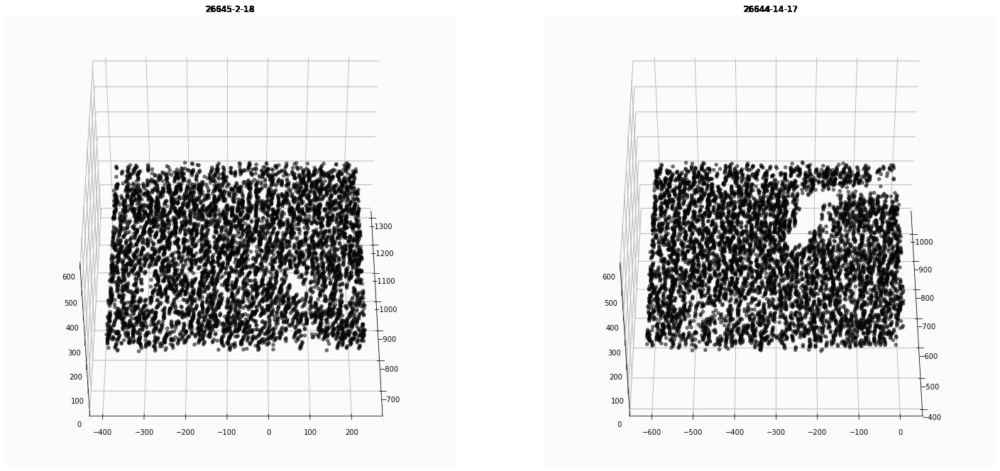

In [542]:
data_keys = list(dataloaders["train"].keys())

with GifMaker(f"scan_fields_evaluation_mice.gif", fps=24) as g:

    for azimuth in np.linspace(0, 360, 180):
        fig = plt.figure(figsize=(25,12))
        
        for i, data_key in enumerate(data_keys):
            ax = fig.add_subplot(1, 2, i+1, projection='3d')
            cell_motor_coordinates = (dataloaders["train"][data_key].dataset.neurons.cell_motor_coordinates)
            ax.scatter3D(*cell_motor_coordinates.T, c='k', edgecolor="k", alpha=0.5)
            ax.view_init(45, azimuth)
            
            # bring all coordinates on the same scale
            ax.set_zlim([0,600])
            ax.set_title(data_key)
        g.add(fig)
g.show()

# Generate Plots for Anatomical Positions and Readout Position

#### helper functions

In [630]:
# smooth color interpolation
def lerp(x, a, b):
    return a + x * (b-a)

# smooth color interpolation
def serp(x, a, b):
    return a + (3*x**2 - 2*x**3) * (b-a)

def get_color(x, y, a, b, c, d, interpolation="linear"):
    if interpolation == "linear":
        img = np.array([lerp(y, lerp(x, a[i], b[i]),
                                 lerp(x, c[i], d[i])) for i in range(3)])
    else:
        img = np.array([serp(y, serp(x, a[i], b[i]),
                                 serp(x, c[i], d[i])) for i in range(3)])
    return img

def get_base_colormap(c1, c2, c3, c4, n=200, interpolation="linear"):

    w = h = n
    verts = [c1,c2,c3,c4]
    img = np.empty((h,w,3), np.uint8)
    for y in range(h):
        for x in range(w):
            img[y,x] = get_color(x/w, y/h, *verts, interpolation=interpolation)
    return img

In [631]:
class ColorMap2D:
    def __init__(self, cmap_array, transpose=False, reverse_x=False, reverse_y=False, xclip=None, yclip=None):
        """
        Maps two 2D array to an RGB color space based on a given reference image.
        Args:
            filename (str): reference image to read the x-y colors from
            rotate (bool): if True, transpose the reference image (swap x and y axes)
            reverse_x (bool): if True, reverse the x scale on the reference
            reverse_y (bool): if True, reverse the y scale on the reference
            xclip (tuple): clip the image to this portion on the x scale; (0,1) is the whole image
            yclip  (tuple): clip the image to this portion on the y scale; (0,1) is the whole image
        """
        #self._colormap_file = filename or COLORMAP_FILE
        #self._img = plt.imread(self._colormap_file)
        self._img = cmap_array
        if transpose:
            self._img = self._img.transpose()
        if reverse_x:
            self._img = self._img[::-1,:,:]
        if reverse_y:
            self._img = self._img[:,::-1,:]
        if xclip is not None:
            imin, imax = map(lambda x: int(self._img.shape[0] * x), xclip)
            self._img = self._img[imin:imax,:,:]
        if yclip is not None:
            imin, imax = map(lambda x: int(self._img.shape[1] * x), yclip)
            self._img = self._img[:,imin:imax,:]
        if issubclass(self._img.dtype.type, np.integer):
            self._img = self._img / 255.0

        self._width = len(self._img)
        self._height = len(self._img[0])

        self._range_x = (0, 1)
        self._range_y = (0, 1)


    @staticmethod
    def _scale_to_range(u: np.ndarray, u_min: float, u_max: float) -> np.ndarray:
        return (u - u_min) / (u_max - u_min)

    def _map_to_x(self, val: np.ndarray) -> np.ndarray:
        xmin, xmax = self._range_x
        val = self._scale_to_range(val, xmin, xmax)
        rescaled = (val * (self._width - 1))
        return rescaled.astype(int)

    def _map_to_y(self, val: np.ndarray) -> np.ndarray:
        ymin, ymax = self._range_y
        val = self._scale_to_range(val, ymin, ymax)
        rescaled = (val * (self._height - 1))
        return rescaled.astype(int)

    def __call__(self, val_x, val_y):
        """
        Take val_x and val_y, and associate the RGB values 
        from the reference picture to each item. val_x and val_y 
        must have the same shape.
        """
        if val_x.shape != val_y.shape:
            raise ValueError(f'x and y array must have the same shape, but have {val_x.shape} and {val_y.shape}.')
        self._range_x = (np.amin(val_x), np.amax(val_x))
        self._range_y = (np.amin(val_y), np.amax(val_y))
        x_indices = self._map_to_x(val_x)
        y_indices = self._map_to_y(val_y)
        i_xy = np.stack((x_indices, y_indices), axis=-1)
        rgb = np.zeros((*val_x.shape, 3))
        for indices in np.ndindex(val_x.shape):
            img_indices = tuple(i_xy[indices])
            rgb[indices] = self._img[img_indices]
        return rgb

    def generate_cbar(self, nx=100, ny=100):
        "generate an image that can be used as a 2D colorbar"
        x = np.linspace(0, 1, nx)
        y = np.linspace(0, 1, ny)
        return self.__call__(*np.meshgrid(x, y))

# Trying out some colormaps

In [632]:
colors = [['#048BA8', '#FFFFFF','#151514','#F18F01'],
           ['#2C8C99', '#FFFFFF','#151514','#931621'],
           ['#87F5FB', '#FFFFFF','#151514','#DE3C4B'],
           ['#3772FF', '#FFFFFF','#151514','#DF2935'],
           ['#9DD9D2', '#FFFFFF','#151514','#FF8811'],
           ['#468189', '#FFFFFF','#151514','#BA274A'],
           ['#6C6EA0', '#FFFFFF','#151514','#D81E5B'],]

### Linear Color Interpolation

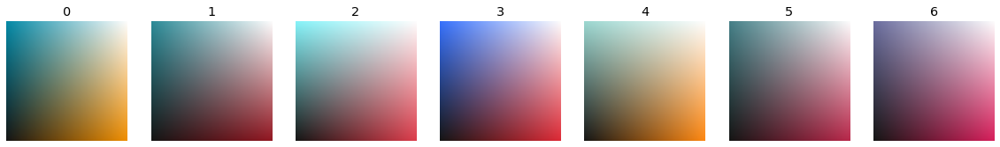

In [633]:
fig, axs = plt.subplots(1, len(colors), figsize=(20,5))
for i, ax in enumerate(axs.ravel()):
    rgb_colors = [ImageColor.getcolor(i, "RGB") for i in colors[i]]
    img = get_base_colormap(*rgb_colors)
    ax.imshow(img)
    ax.axis("off")
    ax.set_title(str(i))

### Smooth Color Interpolation

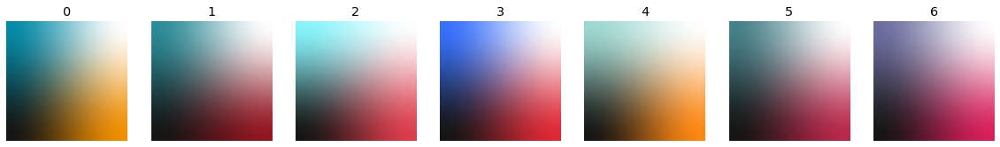

In [634]:
fig, axs = plt.subplots(1, len(colors), figsize=(20,5))
for i, ax in enumerate(axs.ravel()):
    rgb_colors = [ImageColor.getcolor(i, "RGB") for i in colors[i]]
    img = get_base_colormap(*rgb_colors, interpolation="smooth")
    ax.imshow(img)
    ax.axis("off")
    ax.set_title(str(i))

## Pick a color

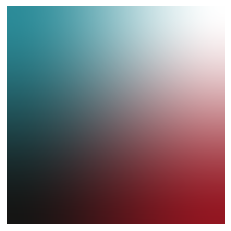

In [912]:
rgb_colors = [ImageColor.getcolor(i, "RGB") for i in colors[1]]
img = get_base_colormap(*rgb_colors, interpolation="smooth")
plt.imshow(img)
plt.axis("off");

### Get Cell and Readout Coordinates

In [913]:
cell_motor_coordinates = (dataloaders["train"][data_key].dataset.neurons.cell_motor_coordinates)

readout_pos = model.readout[data_key].mu.squeeze().detach().cpu().numpy()

### Readout Positions

(-0.4, 0.4)

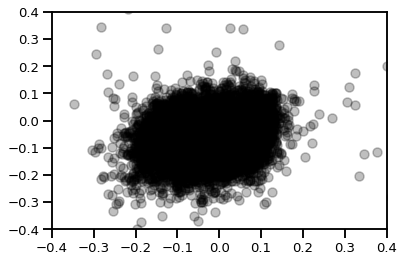

In [914]:
plt.scatter(*readout_pos.T, alpha=.25, c="k",)
plt.xlim([-.4, .4])
plt.ylim([-.4, .4])

### Assign Color based on 2d readout positions

In [915]:
# instantiate 2D Colormap Class with the base colormap
Cmap_2D = ColorMap2D(img,) 
cbar_rgb = Cmap_2D.generate_cbar()

# get RGB tuples for all readout positions based on the colormap
# set vmin/vmax to +- .25
rgb = Cmap_2D(*readout_pos.T.clip(-.25,.25))

# Show

In [916]:
sns.set_context("talk", font_scale=.8)

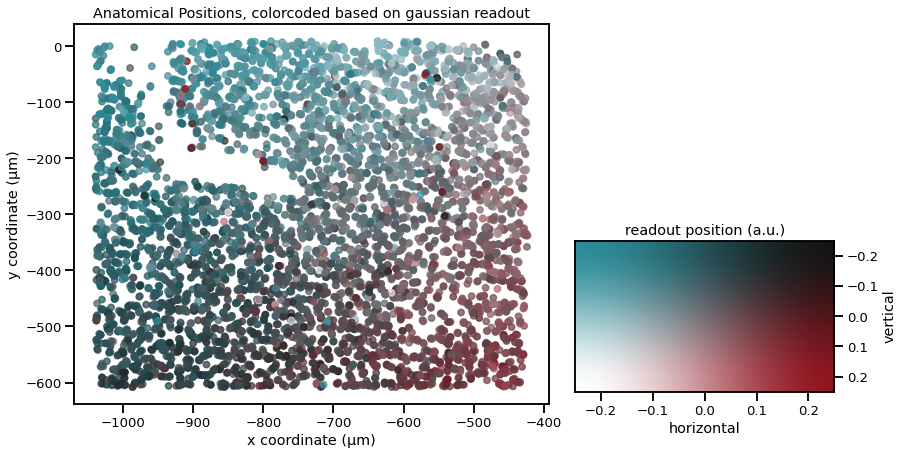

In [917]:
fig, ax = plt.subplots(figsize=(12, 7))

# Show Anatomical Positions
ax.scatter(cell_motor_coordinates[:, 0],cell_motor_coordinates[:,1] ,c=rgb.squeeze(), alpha=.75, s=40,)
ax.set_title("Anatomical Positions, colorcoded based on gaussian readout")
ax.set_xlabel('x coordinate (μm)')
ax.set_ylabel('y coordinate (μm)')

plt.subplots_adjust(left=0.1, right=0.65)

# Show 2D Colormap of the Gaussian Readout
bar_ax = fig.add_axes([0.68, 0.15, 0.3, 0.3])
cmap_extent = (-.25, .25, -.25, .25)
bar_ax.imshow(cbar_rgb, extent=cmap_extent, aspect='auto',origin="lower")

bar_ax.set_title('readout position (a.u.)')
bar_ax.set_xlabel('horizontal')
bar_ax.set_ylabel('vertical')
bar_ax.yaxis.tick_right()
bar_ax.yaxis.set_label_position('right')
bar_ax.invert_yaxis()

plt.show()

# Sanity Checks

### plot the readout positions for individual quadrants of anatomical positions

And It does match with the colors from the RGB plot

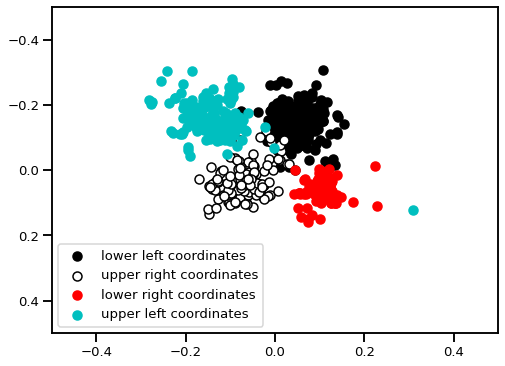

In [918]:
fig, ax = plt.subplots(figsize=(8, 6))
selected_neurons = (cell_motor_coordinates[:,0] < -900) & ((cell_motor_coordinates[:,1] < -500))
ax.scatter(*readout_pos[selected_neurons].T, c="k", label="lower left coordinates")

selected_neurons = (cell_motor_coordinates[:,0] > -500) & ((cell_motor_coordinates[:,1] > -100))
ax.scatter(*readout_pos[selected_neurons].T, c="w", edgecolor="k", label="upper right coordinates")


selected_neurons = (cell_motor_coordinates[:,0] > -500) & ((cell_motor_coordinates[:,1] < -500))
ax.scatter(*readout_pos[selected_neurons].T, c="r", label="lower right coordinates")

selected_neurons = (cell_motor_coordinates[:,0] < -900) & ((cell_motor_coordinates[:,1] > -100))
ax.scatter(*readout_pos[selected_neurons].T, c="c", label="upper left coordinates")
ax.set_xlim([-.5, .5])
ax.set_ylim([-.5, .5])

ax.invert_yaxis()
plt.legend()

# Second Scan

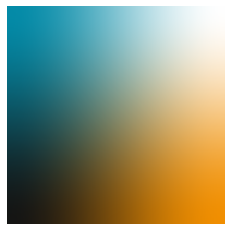

In [903]:
rgb_colors = [ImageColor.getcolor(i, "RGB") for i in colors[0]]
img = get_base_colormap(*rgb_colors, interpolation="smooth")
plt.imshow(img)
plt.axis("off");

### Get Cell and Readout Coordinates

In [906]:
cell_motor_coordinates = (dataloaders["train"][data_keys[0]].dataset.neurons.cell_motor_coordinates)

readout_pos = model.readout[data_keys[0]].mu.squeeze().detach().cpu().numpy()

### Readout Positions

(-0.4, 0.4)

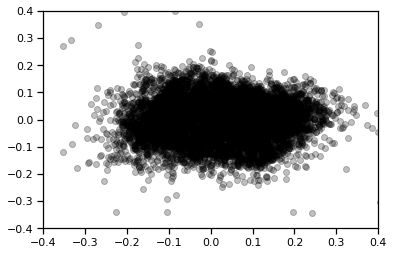

In [907]:
plt.scatter(*readout_pos.T, alpha=.25, c="k",)
plt.xlim([-.4, .4])
plt.ylim([-.4, .4])

### Assign Color based on 2d readout positions

In [908]:
# instantiate 2D Colormap Class with the base colormap
Cmap_2D = ColorMap2D(img,) 
cbar_rgb = Cmap_2D.generate_cbar()

# get RGB tuples for all readout positions based on the colormap
# set vmin/vmax to +- .25
rgb = Cmap_2D(*readout_pos.T.clip(-.25,.25))

# Show

In [909]:
sns.set_context("talk", font_scale=.8)

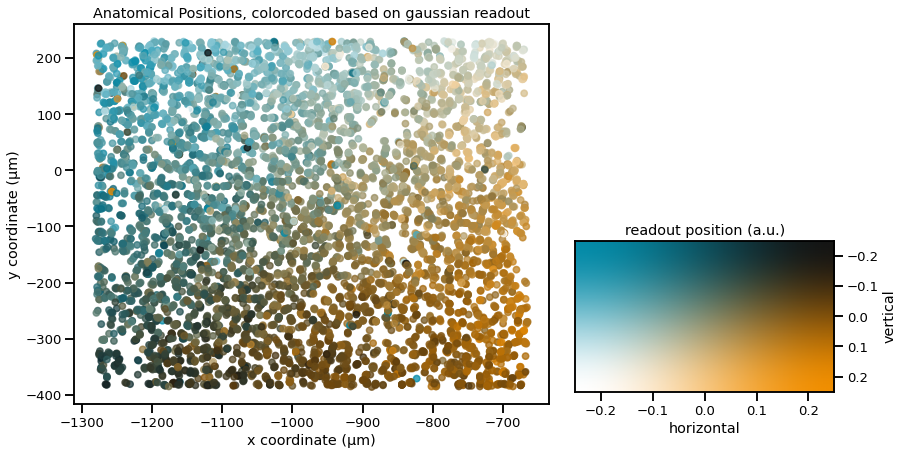

In [910]:
fig, ax = plt.subplots(figsize=(12, 7))

# Show Anatomical Positions
ax.scatter(cell_motor_coordinates[:, 0],cell_motor_coordinates[:,1] ,c=rgb.squeeze(), alpha=.75, s=40,)
ax.set_title("Anatomical Positions, colorcoded based on gaussian readout")
ax.set_xlabel('x coordinate (μm)')
ax.set_ylabel('y coordinate (μm)')

plt.subplots_adjust(left=0.1, right=0.65)

# Show 2D Colormap of the Gaussian Readout
bar_ax = fig.add_axes([0.68, 0.15, 0.3, 0.3])
cmap_extent = (-.25, .25, -.25, .25)
bar_ax.imshow(cbar_rgb, extent=cmap_extent, aspect='auto',origin="lower")

bar_ax.set_title('readout position (a.u.)')
bar_ax.set_xlabel('horizontal')
bar_ax.set_ylabel('vertical')
bar_ax.yaxis.tick_right()
bar_ax.yaxis.set_label_position('right')
bar_ax.invert_yaxis()

plt.show()

# Response Correlation within a scan

In [871]:
from nnfabrik.main import *
dataset_fn, dataset_config = (Dataset() & key).fn_config

In [872]:
dataset_fn = 'cascade.datasets.static_loaders'
dataset_config["return_test_sampler"] = True

oracle_dataloaders = get_data(dataset_fn, dataset_config)

/data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6 exists already. Not unpacking /data/mouse/toliaslab/static/static26645-2-18-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip
/data/mouse/toliaslab/static/static26644-14-17-GrayImageNet-94c6ff995dac583098847cfecd43e7b6 exists already. Not unpacking /data/mouse/toliaslab/static/static26644-14-17-GrayImageNet-94c6ff995dac583098847cfecd43e7b6.zip


In [873]:
responses = []
for b in oracle_dataloaders[data_key]:
    responses.append(b.responses.cpu().squeeze().numpy())
responses = np.vstack(responses)

In [874]:
response_correlations = np.corrcoef(responses, rowvar=False)

In [875]:
tril_corr = np.tril((response_correlations), k=-1)

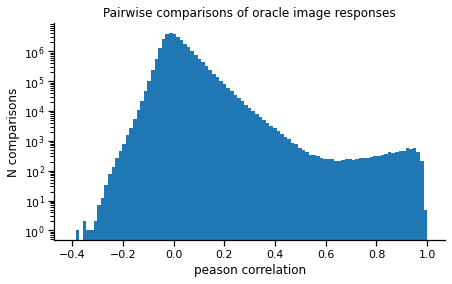

In [876]:
sns.set_context("notebook")
fig, axs = plt.subplots(1,1, figsize=(7,4))
axs.hist(tril_corr[tril_corr!=0], np.linspace(-.4,1,100))
axs.set_yscale('log')

axs.set_xlabel("peason correlation")
axs.set_ylabel("N comparisons")

axs.set_title("Pairwise comparisons of oracle image responses")
sns.despine()

## Scan2

In [866]:
response_correlations = np.corrcoef(responses_2, rowvar=False)

In [867]:
tril_corr = np.tril((response_correlations), k=-1)

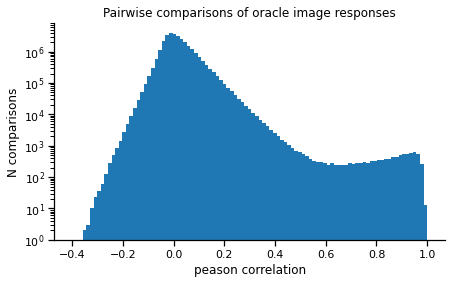

In [868]:
sns.set_context("notebook")
fig, axs = plt.subplots(1,1, figsize=(7,4))
axs.hist(tril_corr[tril_corr!=0], np.linspace(-.4,1,100))
axs.set_yscale('log')

axs.set_xlabel("peason correlation")
axs.set_ylabel("N comparisons")

axs.set_title("Pairwise comparisons of oracle image responses")
sns.despine()

# Across Scans

#### The first 100 Test Images should be identical

In [748]:
data_keys

['26645-2-18', '26644-14-17']

In [786]:
from copy import deepcopy

In [762]:
store_dict = {}
for data_key in data_keys:
    
    imgs, resps = [],[]
    for b in oracle_dataloaders[data_key]:
        resps.append(b.responses.cpu().squeeze().numpy())
        imgs.append(b.images.squeeze().cpu().numpy()[0])
    responses = np.vstack(resps)
    imgs = np.stack(imgs)
    
    store_dict[data_key] = {}
    store_dict[data_key]["responses"] = deepcopy(responses)
    store_dict[data_key]["images"] = deepcopy(imgs)

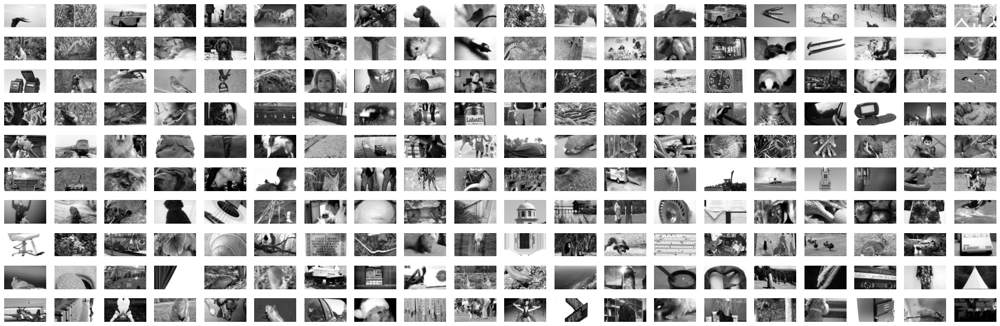

In [763]:
fig, axs = plt.subplots(10,20, figsize=(30,10))
for i, ax in enumerate(axs.ravel()):
    ax.imshow(store_dict[data_keys[0]]["images"][i], cmap="gray")
    ax.axis("off")

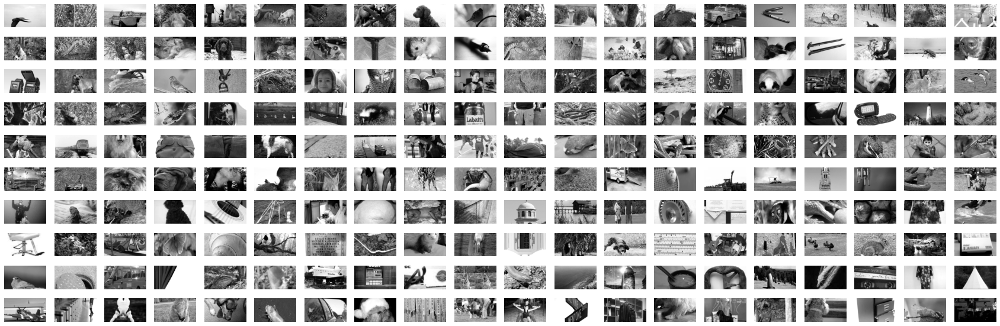

In [764]:
fig, axs = plt.subplots(10,20, figsize=(30,10))
for i, ax in enumerate(axs.ravel()):
    ax.imshow(store_dict[data_keys[1]]["images"][i], cmap="gray")
    ax.axis("off")

### Unfortunately, all 200 images are the same. We need a new test scan

In [ ]:
tiers = dataloaders["train"][data_keys[0]].dataset.trial_info.tiers
image_ids = dataloaders["train"][data_keys[0]].dataset.trial_info.frame_image_id
test_ids_1 = image_ids[tiers=="test"]

tiers = dataloaders["train"][data_keys[1]].dataset.trial_info.tiers
image_ids = dataloaders["train"][data_keys[1]].dataset.trial_info.frame_image_id
test_ids_2 = image_ids[tiers=="test"]

np.isin(test_ids_2, test_ids_1).sum()
# all IDs are identical.

# Compare response correlation across scans

In [834]:
# only take the first 9 repeats per image, so that the arrays have the same size.

store_dict = {}
for data_key in data_keys:
    
    imgs, resps = [],[]
    for b in oracle_dataloaders[data_key]:
        resps.append(b.responses.cpu().squeeze().numpy()[:9, ...])
        imgs.append(b.images.squeeze().cpu().numpy()[0])
    responses = np.vstack(resps)
    imgs = np.stack(imgs)
    
    store_dict[data_key] = {}
    store_dict[data_key]["responses"] = deepcopy(responses)
    store_dict[data_key]["images"] = deepcopy(imgs)

In [835]:
responses_shape = ([store_dict[data_key]["responses"].shape for data_key in data_keys])
responses_shape

[(1800, 7697), (1800, 7672)]

In [836]:
correlations = np.corrcoef(store_dict[data_keys[0]]["responses"].T, store_dict[data_keys[1]]["responses"].T)

In [837]:
correlations_reduced = correlations[:responses_shape[0][1], responses_shape[0][1]:]

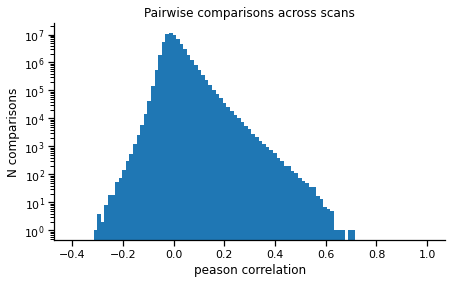

In [838]:
sns.set_context("notebook")
fig, axs = plt.subplots(1,1, figsize=(7,4))
axs.hist(correlations_reduced.flatten(), np.linspace(-.4,1,100))
axs.set_yscale('log')

axs.set_xlabel("peason correlation")
axs.set_ylabel("N comparisons")

axs.set_title("Pairwise comparisons across scans")
sns.despine()

### compute distances between neurons within a Scan

In [900]:
import scipy

In [901]:
distances = np.tril(scipy.spatial.distance.cdist(cell_motor_coordinates, cell_motor_coordinates), k=-1)

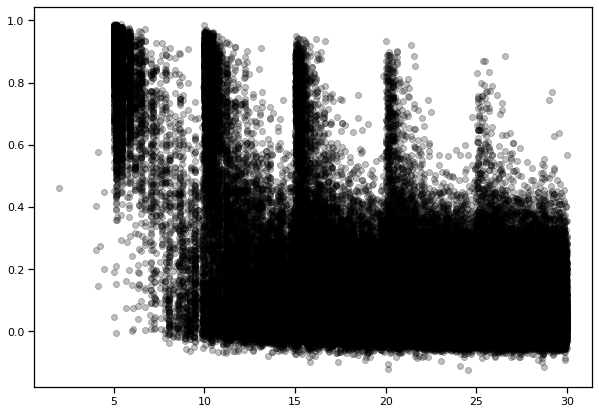

In [902]:
fig, axs = plt.subplots(1,1, figsize=(10,7))
dist_filter = distances[distances!=0]<30
plt.scatter(distances[distances!=0][dist_filter], tril_corr[tril_corr!=0][dist_filter], c="k", alpha=.25)


# ToDo:

- compare correlation within a scan plane across scan planes
- get the exact algorithm for assigning a `munit_id`